# Socioeconomic factors
The UK government produces statistics which describe the socio economic condition in each LSOA within England. These are call the 'Indices of Deprivation' and can be found at https://www.gov.uk/government/statistics/english-indices-of-deprivation-2019. These indices are produced across a number of dimensions, which we describe below, and each LSOA is given a ranking between 1 and 32,844 to represent the RELATIVE deprivation in that neighbourhood and the lower the ranking the more deprived the area. The categories reported are as follows:
- Income: 'Measures the proportion of the population experiencing deprivation relating to low income'
- Employment: 'Measures the proportion of the working age population in an area involuntarily excluded from the labour market'
- Education: 'Measures the lack of attainment and skills in the local population'
- Health: 'Measures the risk of premature death and the impairment of quality of life through poor physical or mental health'
- Crime: 'Measures the risk of personal and material victimisation at local
level'
- Barriers to housing: 'Measures the physical and financial accessibility of housing and local services'
- Living environment: 'Measures the quality of both the ‘indoor’ and ‘outdoor’ local environment'

Unfortunately, ranked data does not tell us the extent of difference in conditions between the 10th ranked LSOA and the 12th, purely that one is more deprived than the other and so these cannot be treated as numeric features. There are potential solutions to this, for example treating it as categorical and then one hot encoding it but that is also problematic given the cardinality in the data. For this reason we will use alternate sources that provide numeric rather than indices data though we will try to compare between the two to ensure that the sorted numeric values in some way coincide with those within the indices.

The London datastore does provide socioeconomic data in the form of ward and LSOA atlases https://data.london.gov.uk/dataset/lsoa-atlas but, because these are based on 2011 census data, one needs to be cognisant that the data would have been 8 years out of date by 2019, the period for which we collated crime data. THis is an issue because this means the socio economic measures would not include the impacts of policy changes post 2010 but unfortunately this is the latest socioeconomic data at LSOA level.

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import altair as alt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
import numpy as np

### Source data manipulation
I had problems loading the original source data and to resolve it I created new tabs, copied the data and removed the headers rows. The new tabs created were as follows:
- data_1 - iadatasheet1
- data_2 - iadatasheet2

In [34]:
column_names = ['lsoa_code', 'lsoa_name', 'population_density', 'lone_parent_pct', 'ethnic_white_pct', 
                'ethnic_mixed_pct', 'ethnic_asian_pct', 'ethnic_black_pct', 
                'ethnic_other_pct', 'homeowner_outright_pct', 'homeowner_mortgage_pct', 'rent_social_pct',
                'rent_private_pct', 'median_house_price']

london_atlas_sheet1 = pd.read_excel(".\DataSources\Income and Deprivation\london_data_atlas_lsoa.xls", 
                                 sheet_name='data_1', header=None,
                                 usecols = "A, B, CY, DH, DQ:DU, FA, FB, FC, FD, FW", 
                                 names=column_names)


print(london_atlas_sheet1.shape)
london_atlas_sheet1.head()

(4835, 14)


,lsoa_code,lsoa_name,population_density,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,homeowner_mortgage_pct,rent_social_pct,rent_private_pct,median_house_price
0,E01000907,Camden 001A,136.753731,21.052632,73.496503,7.272727,8.531469,7.902098,2.797203,12.6,18.0,54.4,13.7,568500
1,E01000908,Camden 001B,94.114286,13.180169,72.422517,8.665402,6.198608,8.032891,4.680582,14.0,17.7,52.6,14.0,350000
2,E01000909,Camden 001C,71.828521,7.261725,84.076828,5.514250,4.646840,2.850062,2.912020,38.3,21.2,18.6,18.8,1412500
3,E01000912,Camden 001D,18.446602,15.714286,77.344242,5.601007,5.097546,9.188169,2.769037,15.3,14.6,51.3,15.0,725000
4,E01000913,Camden 001E,11.298701,3.739612,88.187135,5.087719,4.736842,1.286550,0.701754,47.1,27.6,1.9,19.4,996585


In [35]:
column_names_ = ['lsoa_code', 'unemployed_parents_pct', 'unemployed_lone_parents_pct', 'employment_rate_pct', 
                 'unemployment_rate_pct', 'no_qualifications_pct', 'degree_educated_pct', 'no_cars_pct', 
                'one_car_pct', 'mean_income', 'median_income']

london_atlas_sheet2 = pd.read_excel(".\DataSources\Income and Deprivation\london_data_atlas_lsoa.xls", 
                                 sheet_name='data_2', header=None,
                                 usecols = "A, D, G, N, O, X, AC, AX, AY, BU, BV", 
                                 names=column_names_)


print(london_atlas_sheet2.shape)
london_atlas_sheet2.head()

(4835, 11)


,lsoa_code,unemployed_parents_pct,unemployed_lone_parents_pct,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,mean_income,median_income
0,E01000907,10.4,55.4,58.568738,9.874826,20.0,44.2,61.2,33.0,39985.100588,30222.708219
1,E01000908,5.0,48.6,62.331081,8.043217,15.0,50.4,59.5,34.5,42393.697668,32049.045061
2,E01000909,2.4,59.1,65.682362,4.853273,9.6,61.9,36.8,44.5,77369.830951,58468.946630
3,E01000912,7.0,47.6,58.785425,8.844340,18.0,47.2,60.6,36.1,41737.141713,31551.206573
4,E01000913,0.8,12.5,71.772939,2.076843,4.9,65.2,22.3,42.8,96648.892842,73024.451961


In [36]:
london_atlas_raw = pd.merge(london_atlas_sheet1, london_atlas_sheet2, left_on='lsoa_code', 
                            right_on='lsoa_code', how = 'inner')

print(london_atlas_raw.shape)
london_atlas_raw.head()

(4835, 24)


,lsoa_code,lsoa_name,population_density,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,...,unemployed_parents_pct,unemployed_lone_parents_pct,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,mean_income,median_income
0,E01000907,Camden 001A,136.753731,21.052632,73.496503,7.272727,8.531469,7.902098,2.797203,12.6,...,10.4,55.4,58.568738,9.874826,20.0,44.2,61.2,33.0,39985.100588,30222.708219
1,E01000908,Camden 001B,94.114286,13.180169,72.422517,8.665402,6.198608,8.032891,4.680582,14.0,...,5.0,48.6,62.331081,8.043217,15.0,50.4,59.5,34.5,42393.697668,32049.045061
2,E01000909,Camden 001C,71.828521,7.261725,84.076828,5.514250,4.646840,2.850062,2.912020,38.3,...,2.4,59.1,65.682362,4.853273,9.6,61.9,36.8,44.5,77369.830951,58468.946630
3,E01000912,Camden 001D,18.446602,15.714286,77.344242,5.601007,5.097546,9.188169,2.769037,15.3,...,7.0,47.6,58.785425,8.844340,18.0,47.2,60.6,36.1,41737.141713,31551.206573
4,E01000913,Camden 001E,11.298701,3.739612,88.187135,5.087719,4.736842,1.286550,0.701754,47.1,...,0.8,12.5,71.772939,2.076843,4.9,65.2,22.3,42.8,96648.892842,73024.451961


In [37]:
london_atlas_raw = london_atlas_raw.dropna(how='all') # only drops a row when every column is NA
print(london_atlas_raw.shape)

# Now check for NaN values
nan_values = london_atlas_raw[london_atlas_raw.isna().any(axis=1)]
nan_values

(4835, 24)


,lsoa_code,lsoa_name,population_density,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,...,unemployed_parents_pct,unemployed_lone_parents_pct,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,mean_income,median_income


In [38]:
column_names = london_atlas_raw.columns.to_list()
column_names

['lsoa_code',
 'lsoa_name',
 'population_density',
 'lone_parent_pct',
 'ethnic_white_pct',
 'ethnic_mixed_pct',
 'ethnic_asian_pct',
 'ethnic_black_pct',
 'ethnic_other_pct',
 'homeowner_outright_pct',
 'homeowner_mortgage_pct',
 'rent_social_pct',
 'rent_private_pct',
 'median_house_price',
 'unemployed_parents_pct',
 'unemployed_lone_parents_pct',
 'employment_rate_pct',
 'unemployment_rate_pct',
 'no_qualifications_pct',
 'degree_educated_pct',
 'no_cars_pct',
 'one_car_pct',
 'mean_income',
 'median_income']

In [54]:
pct_fields = [ 'lone_parent_pct',
 'ethnic_white_pct',
 'ethnic_mixed_pct',
 'ethnic_asian_pct',
 'ethnic_black_pct',
 'ethnic_other_pct',
 'homeowner_outright_pct',
 'homeowner_mortgage_pct',
 'rent_social_pct',
 'rent_private_pct',
 'unemployed_parents_pct',
 'unemployed_lone_parents_pct',
 'employment_rate_pct',
 'unemployment_rate_pct',
 'no_qualifications_pct',
 'degree_educated_pct',
 'no_cars_pct',
 'one_car_pct']

other_numeric_fields = ['population_density', 'median_house_price', 'mean_income', 'median_income']

all_numeric_fields = pct_fields + other_numeric_fields

numeric_fields_df = london_atlas_raw[all_numeric_fields].apply(pd.to_numeric,errors='coerce')

# Now check for NaN values

nan_values_ = numeric_fields_df[numeric_fields_df.isna().any(axis=1)]
print(nan_values_.shape)
print("\nfields with nan_values\n")
nan_values_

(3, 22)

fields with nan_values



,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,homeowner_mortgage_pct,rent_social_pct,rent_private_pct,...,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,population_density,median_house_price,mean_income,median_income
138,0.695410,83.075523,2.729754,10.282075,2.183803,1.728844,15.6,16.4,2.5,59.1,...,79.980843,3.269448,1.7,78.2,71.8,20.7,18.123333,850800.0,67266.444489,52427.111884
1347,21.142857,25.468425,8.258154,11.797363,50.242887,4.233171,4.4,5.5,80.8,8.2,...,49.756573,15.050651,25.4,23.9,64.6,29.7,274.108818,NaN,28962.667487,21872.944149
2872,27.366609,63.912201,7.101356,2.840542,24.531956,1.613944,10.7,16.9,67.3,4.6,...,52.911647,11.568938,37.0,11.6,47.2,37.7,60.281470,NaN,27110.930148,21909.717186


### Comments
The following numeric fields need dealing with:
- (index=) 138 - The field with NaN is for LSOA 'City of London 001G' and this is out of scope for our research because we aren't looking into City of London police so delete this row and then turn percentages into proper percentages
- 1347 - Southwark 015C - just set to median_house_price from prior year - 156000
- 2872 - Croydon 030A - just set to median_house_price from prior year - 161000

Then after that, convert percent fields thyrough dividing by 100, standard scale the population density, house price and income fields and then create a tidy dataframe prior to reviewing data distributions.

In [69]:
london_atlas = london_atlas_raw[['lsoa_code', 'lsoa_name']]
london_atlas = london_atlas.join(numeric_fields_df)
print(london_atlas.shape)

london_atlas.loc[london_atlas.lsoa_name == 'Southwark 015C', 'median_house_price'] = 156000
london_atlas.loc[london_atlas.lsoa_name == 'Croydon 030A', 'median_house_price'] = 161000
                  
london_atlas = london_atlas[london_atlas.lsoa_name != 'City of London 001G'].copy().reindex()
                  
print(london_atlas.shape)
london_atlas[london_atlas.lsoa_name.isin(['Croydon 030A', 'Southwark 015C']) ]

(4835, 24)
(4834, 24)


,lsoa_code,lsoa_name,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,homeowner_mortgage_pct,...,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,population_density,median_house_price,mean_income,median_income
1347,E01003968,Southwark 015C,21.142857,25.468425,8.258154,11.797363,50.242887,4.233171,4.4,5.5,...,49.756573,15.050651,25.4,23.9,64.6,29.7,274.108818,156000.0,28962.667487,21872.944149
2872,E01001051,Croydon 030A,27.366609,63.912201,7.101356,2.840542,24.531956,1.613944,10.7,16.9,...,52.911647,11.568938,37.0,11.6,47.2,37.7,60.281470,161000.0,27110.930148,21909.717186


In [86]:
from sklearn.preprocessing import MinMaxScaler

london_atlas_wide = london_atlas[['lsoa_code', 'lsoa_name']]
df_pct_fields = london_atlas[pct_fields].div(100)
df_numeric = london_atlas[other_numeric_fields]

minmax = MinMaxScaler()
minmax = minmax.fit(df_numeric)
numeric_ss = minmax.transform(df_numeric)

df_numeric_ss = pd.DataFrame(numeric_ss, columns=other_numeric_fields)

london_atlas_wide = london_atlas_wide.join(df_pct_fields)
london_atlas_wide = london_atlas_wide.join(df_numeric_ss)
print(london_atlas_wide.shape)
london_atlas_wide.head()

(4834, 24)


,lsoa_code,lsoa_name,lone_parent_pct,ethnic_white_pct,ethnic_mixed_pct,ethnic_asian_pct,ethnic_black_pct,ethnic_other_pct,homeowner_outright_pct,homeowner_mortgage_pct,...,employment_rate_pct,unemployment_rate_pct,no_qualifications_pct,degree_educated_pct,no_cars_pct,one_car_pct,population_density,median_house_price,mean_income,median_income
0,E01000907,Camden 001A,0.210526,0.734965,0.072727,0.085315,0.079021,0.027972,0.126,0.180,...,0.585687,0.098748,0.200,0.442,0.612,0.330,0.168999,0.099591,0.164868,0.184304
1,E01000908,Camden 001B,0.131802,0.724225,0.086654,0.061986,0.080329,0.046806,0.140,0.177,...,0.623311,0.080432,0.150,0.504,0.595,0.345,0.115812,0.052541,0.184848,0.208252
2,E01000909,Camden 001C,0.072617,0.840768,0.055143,0.046468,0.028501,0.029120,0.383,0.212,...,0.656824,0.048533,0.096,0.619,0.368,0.445,0.088014,0.281331,0.474983,0.554677
3,E01000912,Camden 001D,0.157143,0.773442,0.056010,0.050975,0.091882,0.027690,0.153,0.146,...,0.587854,0.088443,0.180,0.472,0.606,0.361,0.021427,0.133290,0.179402,0.201724
4,E01000913,Camden 001E,0.037396,0.881871,0.050877,0.047368,0.012865,0.007018,0.471,0.276,...,0.717729,0.020768,0.049,0.652,0.223,0.428,0.012511,0.191771,0.634907,0.745532


In [87]:
london_atlas_tidy = pd.melt(london_atlas_wide, id_vars=['lsoa_code', 'lsoa_name'], 
                        value_vars=all_numeric_fields, var_name = 'feature', value_name='value')

london_atlas_tidy.head()

,lsoa_code,lsoa_name,feature,value
0,E01000907,Camden 001A,lone_parent_pct,0.210526
1,E01000908,Camden 001B,lone_parent_pct,0.131802
2,E01000909,Camden 001C,lone_parent_pct,0.072617
3,E01000912,Camden 001D,lone_parent_pct,0.157143
4,E01000913,Camden 001E,lone_parent_pct,0.037396


In [88]:
import plotly.express as px
fig = px.box(london_atlas_tidy, x="feature", y="value")
fig.show()

In [94]:
print("Just CrimeOutliers\n")
alt.Chart(london_atlas_tidy).mark_circle(size=60).encode(
    x='value:Q',
    y='feature:O',
    color='feature',
    tooltip=['lsoa_name', 'value']
    ).interactive()

Just CrimeOutliers



alt.Chart(...)

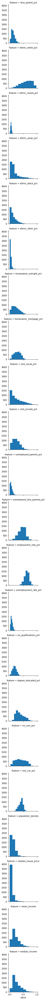

In [93]:
g = sns.FacetGrid(london_atlas_tidy, row = "feature")
g.map(plt.hist, "value")
plt.show()

In [2]:
london_crimes = pd.read_csv("./DataSources/Crime and outcomes/violent_crimes.csv")
crimes_subset = london_crimes[(london_crimes.crime_per_1000 < 62.1) & (london_crimes.crime_per_1000 > 1.35)].copy()
print(crimes_subset.shape)
crimes_subset.head()

(4577, 9)


,lsoa_code,borough,ldn_datastore_total,police_total,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion
0,E01000006,Barking and Dagenham,55,50.0,E01000006,Barking and Dagenham 016A,2094,23.877746,0.175380
2,E01000008,Barking and Dagenham,54,89.0,E01000008,Barking and Dagenham 015B,1597,55.729493,0.409329
3,E01000009,Barking and Dagenham,96,115.0,E01000009,Barking and Dagenham 016B,1929,59.616382,0.437878
5,E01000011,Barking and Dagenham,42,49.0,E01000011,Barking and Dagenham 016C,1726,28.389340,0.208518
6,E01000012,Barking and Dagenham,69,54.0,E01000012,Barking and Dagenham 015D,2343,23.047375,0.169281


In [3]:
socio_economic = pd.read_excel(".\DataSources\Population\lsoa-data_amended.xls",sheet_name='iadatasheet2')
print(socio_economic.shape)
socio_economic.head()

(4835, 8)


,Codes,Names,pct_unemployed,pct_no_qualification,pct_no_cars,num_benefit_claimants,mean_income,median_income
0,E01000907,Camden 001A,10.4,20.0,61.2,180,39985.100588,30222.708219
1,E01000908,Camden 001B,5.0,15.0,59.5,160,42393.697668,32049.045061
2,E01000909,Camden 001C,2.4,9.6,36.8,115,77369.830951,58468.946630
3,E01000912,Camden 001D,7.0,18.0,60.6,160,41737.141713,31551.206573
4,E01000913,Camden 001E,0.8,4.9,22.3,105,96648.892842,73024.451961


In [4]:
child_deprivation_uk = pd.read_excel(".\DataSources\Income and Deprivation\File_3_-_IoD2019_Supplementary_Indices_-_IDACI_and_IDAOPI.xlsx",
                                  sheet_name='IoD2019 IDACI & IDAOPI', skiprows=6, header=None,
                                 usecols = "A,G", names=['code', 'child_deprivation'])

print(child_deprivation_uk.shape)
child_deprivation_uk.head()

socio_economic = pd.merge(socio_economic, child_deprivation_uk, left_on='Codes', 
                            right_on='code', how = 'inner')

print(socio_economic.shape)
socio_economic.head()

(32839, 2)
(4830, 10)


,Codes,Names,pct_unemployed,pct_no_qualification,pct_no_cars,num_benefit_claimants,mean_income,median_income,code,child_deprivation
0,E01000907,Camden 001A,10.4,20.0,61.2,180,39985.100588,30222.708219,E01000907,8030
1,E01000908,Camden 001B,5.0,15.0,59.5,160,42393.697668,32049.045061,E01000908,11335
2,E01000909,Camden 001C,2.4,9.6,36.8,115,77369.830951,58468.946630,E01000909,18495
3,E01000912,Camden 001D,7.0,18.0,60.6,160,41737.141713,31551.206573,E01000912,7975
4,E01000913,Camden 001E,0.8,4.9,22.3,105,96648.892842,73024.451961,E01000913,32243


In [5]:
violence_socio_economic = pd.merge(crimes_subset, socio_economic, left_on='lsoa_code', 
                            right_on='Codes', how = 'inner')

print(violence_socio_economic.shape)
violence_socio_economic.head()

(4576, 19)


,lsoa_code,borough,ldn_datastore_total,police_total,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion,Codes,Names,pct_unemployed,pct_no_qualification,pct_no_cars,num_benefit_claimants,mean_income,median_income,code,child_deprivation
0,E01000008,Barking and Dagenham,54,89.0,E01000008,Barking and Dagenham 015B,1597,55.729493,0.409329,E01000008,Barking and Dagenham 015B,14.0,21.1,58.5,275,28358.780769,24203.851899,E01000008,4452
1,E01000009,Barking and Dagenham,96,115.0,E01000009,Barking and Dagenham 016B,1929,59.616382,0.437878,E01000009,Barking and Dagenham 016B,5.5,18.6,52.7,225,38261.383752,32464.428287,E01000009,10487
2,E01000011,Barking and Dagenham,42,49.0,E01000011,Barking and Dagenham 016C,1726,28.389340,0.208518,E01000011,Barking and Dagenham 016C,8.3,18.0,40.7,225,33132.738921,28128.964538,E01000011,10815
3,E01000012,Barking and Dagenham,69,54.0,E01000012,Barking and Dagenham 015D,2343,23.047375,0.169281,E01000012,Barking and Dagenham 015D,13.6,14.4,52.9,375,32616.734021,27704.709174,E01000012,4419
4,E01000014,Barking and Dagenham,67,43.0,E01000014,Barking and Dagenham 013B,1661,25.888019,0.190146,E01000014,Barking and Dagenham 013B,11.4,31.4,35.9,290,32307.839521,27450.738429,E01000014,9854


In [6]:
other_deprivation_uk = pd.read_excel(".\DataSources\Income and Deprivation\File_4_-_IoD2019_Sub-domains_of_Deprivation.xlsx",
                                  sheet_name='IoD2019 Sub-domains',
                                 usecols = "A,E,G,Q")

print(other_deprivation_uk.shape)
other_deprivation_uk.head()

(32844, 4)


,LSOA code (2011),"Education, Skills and Training Rank (where 1 is most deprived)",Children and Young People Sub-domain Rank (where 1 is most deprived),Living Environment Rank (where 1 is most deprived)
0,E01000001,32842,32777,7789
1,E01000002,32832,32666,13070
2,E01000003,26386,20837,4092
3,E01000005,12370,10914,9397
4,E01000006,17511,21932,10629


In [7]:
violence_socio_economic = pd.merge(violence_socio_economic, other_deprivation_uk, left_on='lsoa_code', 
                            right_on='LSOA code (2011)', how = 'inner')

print(violence_socio_economic.shape)
violence_socio_economic.head()

(4576, 23)


,lsoa_code,borough,ldn_datastore_total,police_total,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion,Codes,...,pct_no_cars,num_benefit_claimants,mean_income,median_income,code,child_deprivation,LSOA code (2011),"Education, Skills and Training Rank (where 1 is most deprived)",Children and Young People Sub-domain Rank (where 1 is most deprived),Living Environment Rank (where 1 is most deprived)
0,E01000008,Barking and Dagenham,54,89.0,E01000008,Barking and Dagenham 015B,1597,55.729493,0.409329,E01000008,...,58.5,275,28358.780769,24203.851899,E01000008,4452,E01000008,10569,14007,8672
1,E01000009,Barking and Dagenham,96,115.0,E01000009,Barking and Dagenham 016B,1929,59.616382,0.437878,E01000009,...,52.7,225,38261.383752,32464.428287,E01000009,10487,E01000009,16819,14445,9611
2,E01000011,Barking and Dagenham,42,49.0,E01000011,Barking and Dagenham 016C,1726,28.389340,0.208518,E01000011,...,40.7,225,33132.738921,28128.964538,E01000011,10815,E01000011,12224,11826,4309
3,E01000012,Barking and Dagenham,69,54.0,E01000012,Barking and Dagenham 015D,2343,23.047375,0.169281,E01000012,...,52.9,375,32616.734021,27704.709174,E01000012,4419,E01000012,13896,10384,5437
4,E01000014,Barking and Dagenham,67,43.0,E01000014,Barking and Dagenham 013B,1661,25.888019,0.190146,E01000014,...,35.9,290,32307.839521,27450.738429,E01000014,9854,E01000014,7994,13822,11704


In [8]:
df_numeric = violence_socio_economic[['pct_unemployed', 
                               'pct_no_qualification', 
                               #'pct_no_cars', 
                               'num_benefit_claimants',
                               'mean_income',
                               'median_income',
                               'child_deprivation',
                               'Education, Skills and Training Rank (where 1 is most deprived)',
                               'Children and Young People Sub-domain Rank (where 1 is most deprived)',
                               'Living Environment Rank (where 1 is most deprived)'
                              ]].copy()

In [9]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
sc = sc.fit(df_numeric)
numeric_ss = sc.transform(df_numeric)

In [10]:
num_col_names = df_numeric.columns
df_numeric_ss = pd.DataFrame(numeric_ss, columns=num_col_names)
print(df_numeric_ss.shape)
df_numeric_ss.head(10)

(4576, 9)


,pct_unemployed,pct_no_qualification,num_benefit_claimants,mean_income,median_income,child_deprivation,"Education, Skills and Training Rank (where 1 is most deprived)",Children and Young People Sub-domain Rank (where 1 is most deprived),Living Environment Rank (where 1 is most deprived)
0,2.149883,0.437779,0.927273,-1.124714,-1.020816,-1.178117,-1.295270,-1.057799,-0.343307
1,-0.045550,0.096158,0.251690,-0.505861,-0.300631,-0.480638,-0.491339,-0.995203,-0.178414
2,0.677651,0.014169,0.251690,-0.826371,-0.678612,-0.442731,-1.082389,-1.369493,-1.109467
3,2.046568,-0.477764,2.278440,-0.858618,-0.715600,-1.181931,-0.867321,-1.575574,-0.911386
4,1.478339,1.845257,1.129948,-0.877922,-0.737742,-0.553796,-1.626489,-1.084238,0.189125
5,2.950570,1.107356,3.224257,-0.926876,-0.793893,-0.892769,-1.327556,-1.016069,0.127137
6,1.375024,2.282531,0.994832,-0.799403,-0.647680,-0.902015,-1.500819,-0.331229,0.208617
7,1.090909,1.831592,1.197507,-0.867256,-0.725507,-1.265490,-1.114803,-0.063695,-0.085344
8,1.943254,1.927246,1.467740,-0.781994,-0.627018,-1.102071,-1.352381,-0.461994,0.131000
9,1.452510,1.476306,0.454365,-0.786568,-0.632424,-0.501673,-1.334502,-0.648496,0.007023


In [11]:
reqd_columns = ['lsoa_code','LSOA Code','lsoa_name','population','crime_per_1000','crime_per_1000_proportion']

transformed_crime= pd.concat([violence_socio_economic[reqd_columns], df_numeric_ss], axis=1)
print(transformed_crime.shape)
transformed_crime.head()

(4576, 15)


,lsoa_code,LSOA Code,lsoa_name,population,crime_per_1000,crime_per_1000_proportion,pct_unemployed,pct_no_qualification,num_benefit_claimants,mean_income,median_income,child_deprivation,"Education, Skills and Training Rank (where 1 is most deprived)",Children and Young People Sub-domain Rank (where 1 is most deprived),Living Environment Rank (where 1 is most deprived)
0,E01000008,E01000008,Barking and Dagenham 015B,1597,55.729493,0.409329,2.149883,0.437779,0.927273,-1.124714,-1.020816,-1.178117,-1.295270,-1.057799,-0.343307
1,E01000009,E01000009,Barking and Dagenham 016B,1929,59.616382,0.437878,-0.045550,0.096158,0.251690,-0.505861,-0.300631,-0.480638,-0.491339,-0.995203,-0.178414
2,E01000011,E01000011,Barking and Dagenham 016C,1726,28.389340,0.208518,0.677651,0.014169,0.251690,-0.826371,-0.678612,-0.442731,-1.082389,-1.369493,-1.109467
3,E01000012,E01000012,Barking and Dagenham 015D,2343,23.047375,0.169281,2.046568,-0.477764,2.278440,-0.858618,-0.715600,-1.181931,-0.867321,-1.575574,-0.911386
4,E01000014,E01000014,Barking and Dagenham 013B,1661,25.888019,0.190146,1.478339,1.845257,1.129948,-0.877922,-0.737742,-0.553796,-1.626489,-1.084238,0.189125


In [12]:
df_numeric = violence_socio_economic[['crime_per_1000',
                               'pct_unemployed', 
                               'pct_no_qualification', 
                               #'pct_no_cars', 
                               'num_benefit_claimants',
                               'mean_income',
                               'median_income',
                               'child_deprivation',
                               'Education, Skills and Training Rank (where 1 is most deprived)',
                               'Children and Young People Sub-domain Rank (where 1 is most deprived)',
                               'Living Environment Rank (where 1 is most deprived)'
                              ]].copy()

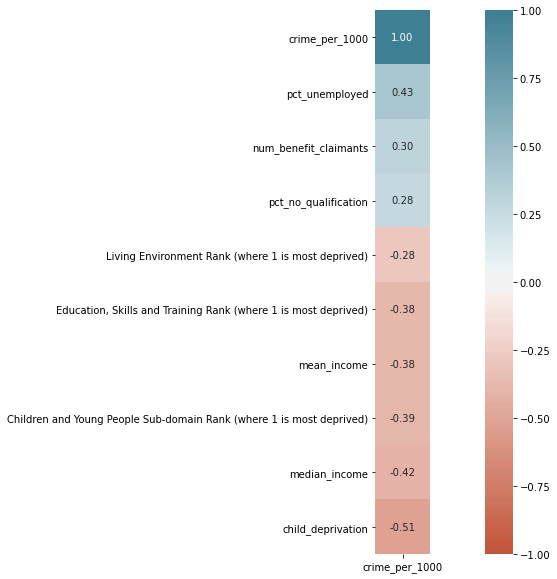

In [13]:
corr = df_numeric.corr()

fig = plt.figure(figsize = (20,10))
sns.heatmap(
    corr[['crime_per_1000']].sort_values(by ='crime_per_1000',ascending=False), 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    annot=True,
    fmt=".2f"
)

In [14]:
import scipy.stats as stats
def PearsonSpearman(feature, outcome, feature_desc):
    corrPearson, pValPearson = stats.pearsonr(feature, outcome)
    corrSpearman, pValSpearman = stats.spearmanr(feature, outcome)
    correlation_result = {'Feature': feature_desc,  
                                            'Pearson': corrPearson, 'PearsonPvalue': pValPearson, 
                                                  'Spearman': corrSpearman, 'SpearmanPvalue': pValSpearman}
    return correlation_result

In [15]:
violence_socio_economic.crime_per_1000,
violence_socio_economic.pct_unemployed, 
violence_socio_economic.median_income
violence_socio_economic.child_deprivation

correlation_results = pd.DataFrame(columns=['Feature', 'Pearson', 'PearsonPvalue', 'Spearman', 'SpearmanPvalue'])

# <------------------------------ Correlations for Deprivation Only ---------------------------->
correlation_results = correlation_results.append(PearsonSpearman(violence_socio_economic.crime_per_1000, violence_socio_economic.pct_unemployed, 
                                                                 'unemployment'), ignore_index=True)
correlation_results = correlation_results.append(PearsonSpearman(violence_socio_economic.crime_per_1000, violence_socio_economic.median_income, 
                                                                 'median income'), ignore_index=True)
correlation_results = correlation_results.append(PearsonSpearman(violence_socio_economic.crime_per_1000, violence_socio_economic.child_deprivation, 
                                                                 'child deprivation'), ignore_index=True)

correlation_results

,Feature,Pearson,PearsonPvalue,Spearman,SpearmanPvalue
0,unemployment,0.427640,6.963116e-203,0.505550,1.636814e-295
1,median income,-0.416375,2.212287e-191,-0.490738,5.302869e-276
2,child deprivation,-0.512673,3.051707e-305,-0.551187,0.000000e+00


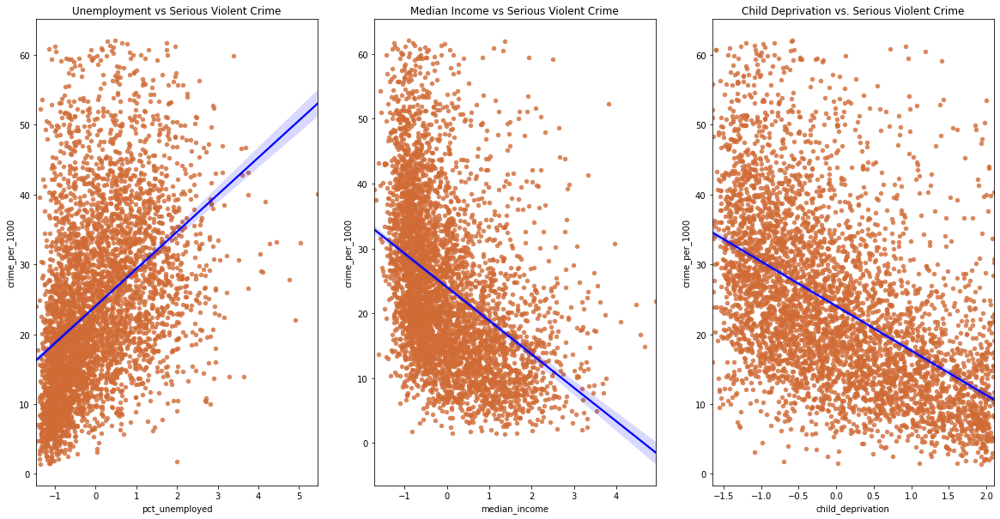

In [22]:
fig = plt.figure(figsize = (20,10))
plt.subplot(1, 3, 1)
plt.title('Unemployment vs Serious Violent Crime')
plt.xlabel('Unemployment')
plt.ylabel('Serious Violent Crime')
plt.scatter(transformed_crime.pct_unemployed,transformed_crime.crime_per_1000 , c = "#D06B36", s = 30, alpha = 0.8, linewidth='0')
sns.regplot(transformed_crime.pct_unemployed,transformed_crime.crime_per_1000, scatter=None, color='blue')

plt.subplot(1,3,2)
plt.title('Median Income vs Serious Violent Crime')
plt.xlabel('Median Income')
plt.ylabel('Serious Violent Crime')
plt.scatter(transformed_crime.median_income,transformed_crime.crime_per_1000 , c = "#D06B36", s = 30, alpha = 0.8, linewidth='0')
sns.regplot(transformed_crime.median_income,transformed_crime.crime_per_1000, scatter=None, color='blue')

plt.subplot(1, 3, 3)
plt.title('Child Deprivation vs. Serious Violent Crime')
plt.xlabel('Child Deprivation')
plt.ylabel('Serious Violent Crime')
plt.scatter(transformed_crime.child_deprivation,transformed_crime.crime_per_1000 , c = "#D06B36", s = 30, alpha = 0.8, linewidth='0')
sns.regplot(transformed_crime.child_deprivation,transformed_crime.crime_per_1000, scatter=None, color='blue')

### Comments
Both the correlations and the scatter plots show that child deprivation has the strongest correlation with serious violent crime and even that correlation is low to moderate (0.51). This in isolation would suggest the Mayor's evidence is shaky at best. However, it would be useful to check the cohen's d for two populations. One with high child deprivation and the second with low child deprivation. However we first need to strip out Westminster LSOAs from the dataset.

In [29]:
remove_list = ['Westminster 018A', 'Westminster 013E', 'Westminster 018C', 'Westminster 013B']

crimes_subset_1 = transformed_crime[~transformed_crime.lsoa_name.isin(remove_list)].copy()

In [36]:
import plotly.express as px

fig = px.box(crimes_subset_1, y="child_deprivation")
fig.show()

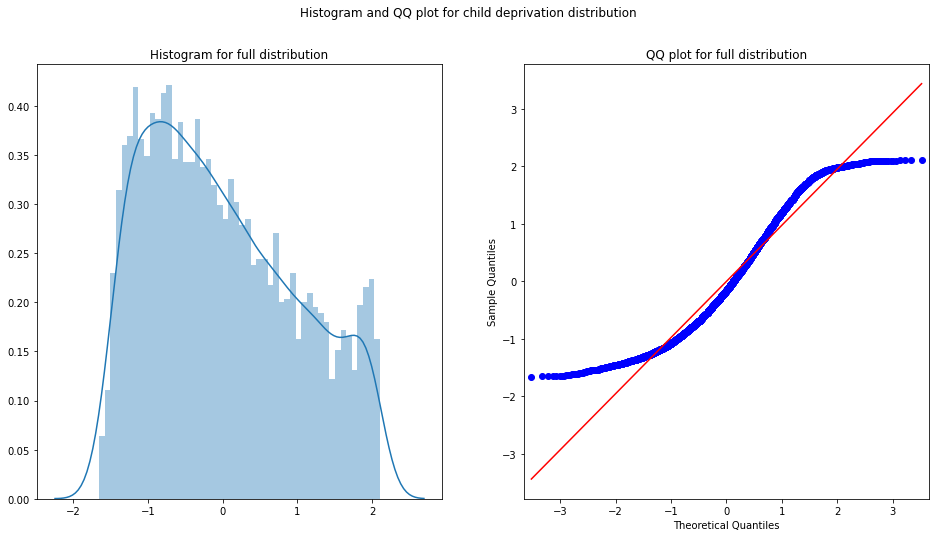

In [43]:
f, axes = plt.subplots(1, 2, figsize=(16,8))
f.suptitle('Histogram and QQ plot for child deprivation distribution')
sns.distplot(np.array(crimes_subset_1.child_deprivation), bins=50, ax=axes[0])
axes[0].set_title('Histogram for full distribution')
sm.qqplot(np.array(crimes_subset_1.child_deprivation), line='r', ax=axes[1])
axes[1].set_title('QQ plot for full distribution')
plt.show()

In [ ]:
# Use numpy to convert to arrays
import numpy as np
# Labels are the values we want to predict
labels = np.array(dataset['high_violence'])
# Remove the labels from the features
# axis 1 refers to the columns
dataset= dataset.drop('high_violence', axis = 1)
# Saving feature names for later use
feature_list = list(dataset.columns)
# Convert to numpy array
features = np.array(dataset)

In [ ]:
# Using Skicit-learn to split data into training and testing sets
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [ ]:
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from collections import Counter

In [ ]:
# using naive oversampling I get a dataset with 27404 = y and same number =n
#from imblearn.over_sampling import RandomOverSampler
#ros = RandomOverSampler(random_state=0)
#X_resampled, y_resampled = ros.fit_resample(X_train, y_train)

from imblearn.over_sampling import SMOTE, ADASYN
X_resampled, y_resampled = SMOTE().fit_resample(train_features, train_labels)

y_resampled.shape, X_resampled.shape

In [ ]:
# Import the model we are using
from sklearn.ensemble import RandomForestClassifier
# Instantiate model with 1000 decision trees
rf = RandomForestClassifier(n_estimators = 1000, oob_score = True,
                           bootstrap = True, random_state = 42)
# Train the model on training data
rf.fit(X_resampled, y_resampled);

print('R^2 Training Score: {:.2f} \nOOB Score: {:.2f} \nR^2 Validation Score: {:.2f}'.format(rf.score(X_resampled, y_resampled), 
                                                                                             rf.oob_score_,
                                                                                             rf.score(test_features, test_labels)))

In [ ]:
#dataset = vio_socio_injury[['pct_unemployed', 
#                               'pct_no_qualification', 
#                               'pct_no_cars', 
#                               'num_benefit_claimants',
#                               'mean_income',
#                               'median_income',
#                               'child_deprivation',
#                               'Education, Skills and Training Rank (where 1 is most deprived)',
#                               'Children and Young People Sub-domain Rank (where 1 is most deprived)',
#                               'Living Environment Rank (where 1 is most deprived)',
#                               'high_violence'
#                              ]].copy()

## random forests 
Stuff largely taken from 
https://towardsdatascience.com/random-forest-in-python-24d0893d51c0

In [ ]:
# Use numpy to convert to arrays
import numpy as np
# Labels are the values we want to predict
labels = np.array(dataset['high_violence'])
# Remove the labels from the features
# axis 1 refers to the columns
dataset= dataset.drop('high_violence', axis = 1)
# Saving feature names for later use
feature_list = list(dataset.columns)
# Convert to numpy array
features = np.array(dataset)

In [ ]:
# Using Skicit-learn to split data into training and testing sets
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [ ]:
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

In [ ]:
# Import the model we are using
from sklearn.ensemble import RandomForestClassifier
# Instantiate model with 1000 decision trees
rf = RandomForestClassifier(n_estimators = 1000, oob_score = True,
                           bootstrap = True, random_state = 42)
# Train the model on training data
rf.fit(train_features, train_labels);

print('R^2 Training Score: {:.2f} \nOOB Score: {:.2f} \nR^2 Validation Score: {:.2f}'.format(rf.score(train_features, train_labels), 
                                                                                             rf.oob_score_,
                                                                                             rf.score(test_features, test_labels)))

### Comments
Well, there is some overfitting in the model, as it performs much worse on OOB sample and worse on the validation set.

In [ ]:
import time
import numpy as np

start_time = time.time()
importances = rf.feature_importances_
std = np.std([
    tree.feature_importances_ for tree in rf.estimators_], axis=0)
elapsed_time = time.time() - start_time

print(f"Elapsed time to compute the importances: "
      f"{elapsed_time:.3f} seconds")

In [ ]:
feature_list

In [ ]:
feature_names = [f'feature {i}' for i in range(features.shape[1])]

forest_importances = pd.Series(importances, index=feature_names)

fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=std, ax=ax)
ax.set_title("Feature importances using MDI")
ax.set_ylabel("Mean decrease in impurity")
fig.tight_layout()

### Comments
It looks like features 2, 3, 6 and 9 have the biggest impact. These are: pct_no_cars, num_benefit_claimants, child_deprivation, Living Environment Rank.

So redo, using just these fields - 

what I found was that this increased recall but reduced precision. so try again

In [ ]:
dataset = vio_socio_injury[['pct_no_cars', 
                               'num_benefit_claimants',
                               'child_deprivation',
                               'Living Environment Rank (where 1 is most deprived)',
                               'high_violence'
                              ]].copy()

In [ ]:
# Labels are the values we want to predict
labels = np.array(dataset['high_violence'])
# Remove the labels from the features
# axis 1 refers to the columns
dataset= dataset.drop('high_violence', axis = 1)
# Saving feature names for later use
feature_list = list(dataset.columns)
# Convert to numpy array
features = np.array(dataset)

In [ ]:
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [ ]:
rf = RandomForestClassifier(n_estimators = 1000, oob_score = True,
                           bootstrap = True, random_state = 42)
# Train the model on training data
rf.fit(train_features, train_labels);

print('R^2 Training Score: {:.2f} \nOOB Score: {:.2f} \nR^2 Validation Score: {:.2f}'.format(rf.score(train_features, train_labels), 
                                                                                             rf.oob_score_,
                                                                                             rf.score(test_features, test_labels)))

In [ ]:
from sklearn.inspection import permutation_importance

start_time = time.time()
result = permutation_importance(
    rf, test_features, test_labels, n_repeats=10, random_state=42, n_jobs=2)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: "
      f"{elapsed_time:.3f} seconds")

forest_importances = pd.Series(result.importances_mean, index=feature_names)

In [ ]:
fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances using permutation on full model")
ax.set_ylabel("Mean accuracy decrease")
fig.tight_layout()
plt.show()

### Comments
In this case we have bigger important for 0, 2, and 3 i.e. 'pct_unemployed', 'pct_no_cars', 'num_benefit_claimants' so lets try that

In [ ]:
dataset = vio_socio_injury[['pct_unemployed', 
                               'pct_no_cars',
                               'num_benefit_claimants',
                               'high_violence'
                              ]].copy()

In [ ]:
# Labels are the values we want to predict
labels = np.array(dataset['high_violence'])
# Remove the labels from the features
# axis 1 refers to the columns
dataset= dataset.drop('high_violence', axis = 1)
# Saving feature names for later use
feature_list = list(dataset.columns)
# Convert to numpy array
features = np.array(dataset)

In [ ]:
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

In [ ]:
rf = RandomForestClassifier(n_estimators = 1000, oob_score = True,
                           bootstrap = True, random_state = 42)
# Train the model on training data
rf.fit(train_features, train_labels);

print('R^2 Training Score: {:.2f} \nOOB Score: {:.2f} \nR^2 Validation Score: {:.2f}'.format(rf.score(train_features, train_labels), 
                                                                                             rf.oob_score_,
                                                                                             rf.score(test_features, test_labels)))

### Comments
This had crap results for everything so don't use

In [ ]:
# Calculate feature importances
importances = rf.feature_importances_
# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

indices

In [ ]:
feature_list = list(dataset.columns)

feature_list[0]

In [ ]:


# Rearrange feature names so they match the sorted feature importances
names = [feature_list[i] for i in indices]

# Barplot: Add bars
plt.bar(range(dataset.shape[1]), importances[indices])
# Add feature names as x-axis labels
plt.xticks(range(dataset.shape[1]), names, rotation=20, fontsize = 8)
# Create plot title
plt.title("Feature Importance")
# Show plot
plt.show()

In [ ]:
# Use the forest's predict method on the test data
predictions = rf.predict(test_features)
predictions[0:10]

In [ ]:
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

In [ ]:
def RF_performance_reporting(y_pred, y_test, description, print_output=True):    
    # I now want to create a confusion matrix and to do this I first have to 
    # change my model output from a probability to a label 1 or 0
   
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred)
    cm = confusion_matrix(y_test, y_pred)
    
    tn, fp, fn, tp = confusion_matrix(y_test,y_pred).ravel()
    
    if print_output:
        
        print('------------------------------------------------------------------')
        print('Printing performance metrics for ' + description)
        print('------------------------------------------------------------------\n')
        print('prediction accuracy', accuracy)
        print('precision', precision)
        print('recall', recall)
        print('Area under the curve score', roc_auc)   
        print('\n')  

        fpr, tpr, thresholds = roc_curve(y_test, y_pred)

        plt.figure()
        lw = 2
        plt.plot(fpr, tpr, color='darkorange',
             lw=lw, label='ROC curve')
        plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver operating characteristic example')
        plt.legend(loc="lower right")
        plt.show()
    
        print('\n Confusion Matrix - numbers\n')
        print(cm)
        
    return accuracy, precision, recall, roc_auc, tn, fp, fn, tp

accuracy, precision, recall, roc_auc, tn, fp, fn, tp = RF_performance_reporting(predictions, test_labels, 'socio', print_output=True)

In [ ]:
dataset_1 = vio_socio_injury[['pct_unemployed', 
                               'pct_no_qualification', 
                               'pct_no_cars', 
                               'num_benefit_claimants',
                               'mean_income',
                               'median_income',
                               'child_deprivation',
                               'Education, Skills and Training Rank (where 1 is most deprived)',
                               'Children and Young People Sub-domain Rank (where 1 is most deprived)',
                               'Living Environment Rank (where 1 is most deprived)',
                               'log_total'
                              ]].copy()

In [ ]:
corr = dataset_1.corr()
plt.figure(figsize = (8,8))

ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True,
    annot=True,
    fmt=".2f"
)